In [13]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import numpy as np
import cv2
import os
import random
from PIL import Image
import matplotlib.pyplot as plt
from PIL import ImageFilter
import torchvision.transforms as transforms

In [14]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [15]:
# Dark Channel Prior functions
def dark_channel_prior(image, window_size=15):
    dark_channel = np.min(image, axis=2)
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (window_size, window_size))
    dark_channel = cv2.erode(dark_channel, kernel)
    return dark_channel
def atmospheric_light(image, dark_channel):
    num_pixels = image.shape[0] * image.shape[1]
    num_brightest = int(max(num_pixels * 0.001, 1))
    indices = np.argsort(dark_channel.ravel())[-num_brightest:]
    brightest_pixels = image.reshape(-1, 3)[indices]
    A = brightest_pixels.mean(axis=0)
    return A
def transmission_estimate(image, A, omega=0.95, window_size=15):
    norm_image = image / A
    transmission = 1 - omega * dark_channel_prior(norm_image, window_size)
    return transmission
def recover_image(image, transmission, A, t_min=0.1):
    transmission = np.maximum(transmission, t_min)
    transmission = transmission[..., np.newaxis]
    J = (image - A) / transmission + A
    J = np.clip(J, 0, 1)
    return J

In [16]:
class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1, padding=1):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=padding)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=stride, padding=padding)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.skip_connection = nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride, padding=0) if in_channels != out_channels else None

    def forward(self, x):
        identity=x
        if self.skip_connection:
            identity=self.skip_connection(x)
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.conv2(out)
        out = self.bn2(out)
        out += identity  # Add skip connection
        out = self.relu(out)
        return out

In [17]:
class ChannelAttention(nn.Module):
    def __init__(self, in_channels, reduction=16):
        super(ChannelAttention, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)
        
        self.fc = nn.Sequential(
            nn.Conv2d(in_channels, in_channels // reduction, 1, bias=False),
            nn.ReLU(inplace=True),
            nn.Conv2d(in_channels // reduction, in_channels, 1, bias=False)
        )
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = self.fc(self.avg_pool(x))
        max_out = self.fc(self.max_pool(x))
        out = avg_out + max_out
        return self.sigmoid(out) * x

In [18]:
class SpatialAttention(nn.Module):
    def __init__(self, kernel_size=7):
        super(SpatialAttention, self).__init__()
        assert kernel_size in (3, 7), 'Kernel size must be 3 or 7'
        padding = (kernel_size - 1) // 2
        self.conv = nn.Conv2d(2, 1, kernel_size, padding=padding, bias=False)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg_out = torch.mean(x, dim=1, keepdim=True)
        max_out, _ = torch.max(x, dim=1, keepdim=True)
        out = torch.cat([avg_out, max_out], dim=1)
        out = self.conv(out)
        return self.sigmoid(out) * x

In [19]:
# class ImprovedDehazeNet(nn.Module):
#     def __init__(self):
#         super(ImprovedDehazeNet, self).__init__()
#         self.res1 = ResidualBlock(4, 64)
#         self.res2 = ResidualBlock(64, 128)
#         self.res3 = ResidualBlock(128, 256)
#         self.spatial_attention = SpatialAttention()  # Spatial attention first
#         self.channel_attention = ChannelAttention(in_channels=256)
#         self.deconv1 = nn.ConvTranspose2d(256, 128, kernel_size=3, padding=1)
#         self.deconv2 = nn.ConvTranspose2d(128, 64, kernel_size=3, padding=1)
#         self.deconv3 = nn.ConvTranspose2d(64, 3, kernel_size=3, padding=1)
#         self.dropout = nn.Dropout(0.5) 

#     def forward(self, x, dcp_features):
#         x = torch.cat((x.to(device), dcp_features.to(device)), dim=1)
#         x = self.res1(x)
#         x = self.res2(x)
#         x = self.res3(x)
#         x = self.spatial_attention(x)  # Spatial attention first
#         x = self.channel_attention(x)  # Channel attention second
#         x = F.relu(self.deconv1(x))
#         x = self.dropout(F.relu(self.deconv2(x + x)))
#         x = self.deconv3(x + x)
#         return x
import torch
import torch.nn as nn
import torch.nn.functional as F

class ImprovedDehazeNet(nn.Module):
    def __init__(self, num_residual_blocks=5):
        super(ImprovedDehazeNet, self).__init__()
        
        # Initial residual block
        self.initial_block = ResidualBlock(4, 64)
        
        # List to hold residual blocks
        self.residual_layers = nn.ModuleList()
        in_channels = 64
        
        # Create a specified number of residual blocks
        for i in range(num_residual_blocks):
            out_channels = in_channels * 2 if i % 2 == 0 else in_channels
            self.residual_layers.append(ResidualBlock(in_channels, out_channels))
            in_channels = out_channels
        
        # Attention layers
        self.spatial_attention = SpatialAttention()
        self.channel_attention = ChannelAttention(in_channels)
        
        # Deconvolutional layers for upsampling
        self.deconv1 = nn.ConvTranspose2d(in_channels, 128, kernel_size=3, padding=1)
        self.deconv2 = nn.ConvTranspose2d(128, 64, kernel_size=3, padding=1)
        self.deconv3 = nn.ConvTranspose2d(64, 3, kernel_size=3, padding=1)
        
        # Dropout for regularization
        self.dropout = nn.Dropout(0.5)

    def forward(self, x, dcp_features):
        # Concatenate input with additional features
        x = torch.cat((x, dcp_features), dim=1)
        
        # Pass through the initial block
        x = self.initial_block(x)
        
        # Pass through all residual blocks
        for layer in self.residual_layers:
            x = layer(x)
        
        # Attention mechanisms
        x = self.spatial_attention(x)
        x = self.channel_attention(x)
        
        # Upsampling layers
        x = F.relu(self.deconv1(x))
        x = self.dropout(F.relu(self.deconv2(x + x)))  # Skip connection
        x = self.deconv3(x + x)  # Skip connection
        
        return x

# Define your ResidualBlock, ChannelAttention, and SpatialAttention classes here


In [20]:
def initialize_weights(m):
    if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d)):
        nn.init.xavier_uniform_(m.weight)
    elif isinstance(m, nn.BatchNorm2d):
        nn.init.constant_(m.weight, 1)

        nn.init.constant_(m.bias, 0)

In [21]:
def load_image(path, size=(256, 256)):
    image = Image.open(path).convert('RGB')
    image = image.resize(size)
    image = np.asarray(image) / 255.0
    return image
def image_to_tensor(image):
    if len(image.shape) == 3 and image.shape[2] == 3:  # RGB image
        image = torch.FloatTensor(image).permute(2, 0, 1).unsqueeze(0)
    elif len(image.shape) == 2:  # Grayscale image
        image = torch.FloatTensor(image).unsqueeze(0).unsqueeze(0)
    else:
        raise ValueError("Unsupported image dimensions")
    return image
def tensor_to_image(tensor):
    image = tensor.cpu().squeeze(0).permute(1, 2, 0).detach().numpy()
    image = np.clip(image, 0, 1)
    return image
import os

def extract_haze_value_from_filename(filename):
    # Example file pattern: '1_1_0.90179.png', we want to extract '0.90179'
    try:
        haze_value = float(filename.split('_')[-1].replace('.png', '').replace('.jpg', ''))
        return haze_value
    except Exception as e:
        print(f"Error extracting haze value from {filename}: {e}")
        return None

def get_image_files(dataset_type, base_dir):
    hazy_images = []
    clear_images = []

    if dataset_type == 'NH-HAZE':
        hazy_dir = os.path.join(base_dir, 'hazy')
        clear_dir = os.path.join(base_dir, 'GT')
        hazy_images = sorted([os.path.join(hazy_dir, img) for img in os.listdir(hazy_dir) if img.endswith('.png')])
        clear_images = sorted([os.path.join(clear_dir, img.replace('hazy', 'GT')) for img in os.listdir(hazy_dir)])

    elif dataset_type == 'Dense_Haze_NTIRE19':
        hazy_dir = os.path.join(base_dir, 'hazy')
        clear_dir = os.path.join(base_dir, 'GT')
        hazy_images = sorted([os.path.join(hazy_dir, img) for img in os.listdir(hazy_dir) if img.endswith('.png')])
        clear_images = sorted([os.path.join(clear_dir, img.replace('hazy', 'GT')) for img in os.listdir(hazy_dir)])

    elif dataset_type == 'SOTIndoor':
        hazy_dir = os.path.join(base_dir, 'hazy')
        clear_dir = os.path.join(base_dir, 'gt')
        hazy_images = sorted([os.path.join(hazy_dir, img) for img in os.listdir(hazy_dir) if img.endswith('.png')])
        clear_images = sorted([os.path.join(clear_dir, img.split('_')[0] + '.png') for img in os.listdir(hazy_dir)])

    elif dataset_type == 'SOTOutdoor':
        hazy_dir = os.path.join(base_dir, 'hazy')
        clear_dir = os.path.join(base_dir, 'gt')
        hazy_images = sorted([os.path.join(hazy_dir, img) for img in os.listdir(hazy_dir) if img.endswith('.jpg')])
        clear_images = sorted([os.path.join(clear_dir, img.split('_')[0] + '.png') for img in os.listdir(hazy_dir)])

    elif dataset_type == 'archiveindoor':
        hazy_dir = os.path.join(base_dir, 'hazy')
        clear_dir = os.path.join(base_dir, 'clear')
        hazy_images = sorted([os.path.join(hazy_dir, img) for img in os.listdir(hazy_dir) if img.endswith('.png')])
        clear_images = sorted([os.path.join(clear_dir, img.split('_')[0] + '.png') for img in os.listdir(hazy_dir)])

    elif dataset_type == 'archiveoutdoor':
        hazy_dir = os.path.join(base_dir, 'hazy')
        clear_dir = os.path.join(base_dir, 'clear')
        hazy_images = sorted([os.path.join(hazy_dir, img) for img in os.listdir(hazy_dir) if img.endswith('.jpg')])
        clear_images = sorted([os.path.join(clear_dir, img) for img in os.listdir(clear_dir) if img.endswith('.png')])

        hazy_image_map = {}
        for hazy_img in hazy_images:
            base_name = os.path.basename(hazy_img).split('_')[0]
            hazy_image_map.setdefault(base_name, []).append(hazy_img)

        matched_hazy_images = []
        matched_clear_images = []
        for clear_img in clear_images:
            base_name = os.path.basename(clear_img).split('.')[0]
            if base_name in hazy_image_map:
                matched_clear_images.append(clear_img)
                matched_hazy_images.extend(hazy_image_map[base_name])

        hazy_images = matched_hazy_images
        clear_images = matched_clear_images

    else:
        raise ValueError(f"Unsupported dataset type: {dataset_type}")

    print(f"Dataset type: {dataset_type}")
    print(f"Number of hazy images: {len(hazy_images)}")
    print(f"Number of clear images: {len(clear_images)}")

    # Handle mismatched numbers of hazy and clear images
    if len(hazy_images) == 0 or len(clear_images) == 0:
        raise RuntimeError("No valid images found in one of the directories.")

    if len(hazy_images) > len(clear_images):
        clear_images = clear_images * (len(hazy_images) // len(clear_images)) + clear_images[:len(hazy_images) % len(clear_images)]
    elif len(clear_images) > len(hazy_images):
        hazy_images = hazy_images * (len(clear_images) // len(hazy_images)) + hazy_images[:len(clear_images) % len(hazy_images)]

    return hazy_images, clear_images
def load_multiple_datasets_batch(dataset_types, base_dirs, size=(256, 256)):
    all_hazy_tensors = []
    all_clear_tensors = []
    all_dcp_tensors = []

    print("Starting dataset loading...")
    for dataset_type, base_dir in zip(dataset_types, base_dirs):
        print(f"Processing dataset: {dataset_type} from {base_dir}")
        hazy_images, clear_images = get_image_files(dataset_type, base_dir)

        if not hazy_images or not clear_images:
            print(f"No images found for dataset: {dataset_type}")
            continue

        batch_hazy_tensors = []
        batch_clear_tensors = []
        batch_dcp_tensors = []

        for hazy_path, clear_path in zip(hazy_images, clear_images):
            #print(f"Loading images: {hazy_path} and {clear_path}")
            hazy_image = load_image(hazy_path, size)
            clear_image = load_image(clear_path, size)

            if hazy_image is None or clear_image is None:
                print(f"Failed to load images: {hazy_path}, {clear_path}")
                continue

            dark_channel = dark_channel_prior(hazy_image)
            A = atmospheric_light(hazy_image, dark_channel)
            transmission = transmission_estimate(hazy_image, A)

            hazy_tensor = image_to_tensor(hazy_image)
            clear_tensor = image_to_tensor(clear_image)
            dcp_tensor = image_to_tensor(transmission)

            batch_hazy_tensors.append(hazy_tensor)
            batch_clear_tensors.append(clear_tensor)
            batch_dcp_tensors.append(dcp_tensor)

        if batch_hazy_tensors:
            all_hazy_tensors.append(torch.cat(batch_hazy_tensors, dim=0))
            all_clear_tensors.append(torch.cat(batch_clear_tensors, dim=0))
            all_dcp_tensors.append(torch.cat(batch_dcp_tensors, dim=0))
        else:
            print(f"No valid tensors for dataset: {dataset_type}")

    if all_hazy_tensors:
        combined_hazy = torch.cat(all_hazy_tensors, dim=0)
        combined_clear = torch.cat(all_clear_tensors, dim=0)
        combined_dcp = torch.cat(all_dcp_tensors, dim=0)
        print("Dataset loading complete.")
    else:
        raise RuntimeError("No valid data to concatenate.")

    return combined_hazy, combined_clear, combined_dcp
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [22]:
import torch
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
import matplotlib.pyplot as plt
dataset_types = ['NH-HAZE', 'Dense_Haze_NTIRE19', 'SOTIndoor', 'SOTOutdoor', 'archiveindoor', 'archiveoutdoor']
base_dirs = [
    '/kaggle/input/nhdataset/NH-HAZE',
    '/kaggle/input/densehaze/Dense_Haze_NTIRE19',
    '/kaggle/input/sotsdata/SOTS/indoor',
    '/kaggle/input/sotsdata/SOTS/outdoor',
    '/kaggle/input/archive/archive/indoor',
    '/kaggle/input/archive/archive/outdoor']

hazy_images, clear_images, dcp_images = load_multiple_datasets_batch(dataset_types, base_dirs)

# Split into training and validation sets (e.g., 80% train, 20% validation)
split_idx = int(0.8 * len(hazy_images))
train_hazy, val_hazy = hazy_images[:split_idx], hazy_images[split_idx:]
train_clear, val_clear = clear_images[:split_idx], clear_images[split_idx:]
train_dcp, val_dcp = dcp_images[:split_idx], dcp_images[split_idx:]

# Correctly create training and validation datasets using the splits
train_dataset = torch.utils.data.TensorDataset(train_hazy, train_clear, train_dcp)
train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True)
val_dataset = torch.utils.data.TensorDataset(val_hazy, val_clear, val_dcp)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=8, shuffle=False)

Starting dataset loading...
Processing dataset: NH-HAZE from /kaggle/input/nhdataset/NH-HAZE
Dataset type: NH-HAZE
Number of hazy images: 55
Number of clear images: 55
Processing dataset: Dense_Haze_NTIRE19 from /kaggle/input/densehaze/Dense_Haze_NTIRE19
Dataset type: Dense_Haze_NTIRE19
Number of hazy images: 55
Number of clear images: 55
Processing dataset: SOTIndoor from /kaggle/input/sotsdata/SOTS/indoor
Dataset type: SOTIndoor
Number of hazy images: 500
Number of clear images: 500
Processing dataset: SOTOutdoor from /kaggle/input/sotsdata/SOTS/outdoor
Dataset type: SOTOutdoor
Number of hazy images: 500
Number of clear images: 500
Processing dataset: archiveindoor from /kaggle/input/archive/archive/indoor
Dataset type: archiveindoor
Number of hazy images: 500
Number of clear images: 500
Processing dataset: archiveoutdoor from /kaggle/input/archive/archive/outdoor
Dataset type: archiveoutdoor
Number of hazy images: 500
Number of clear images: 492
Dataset loading complete.


In [23]:
import torch
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torchvision import models  # Import torchvision models
import matplotlib.pyplot as plt
import os

# Ensure `device` is defined
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
from torch.cuda.amp import autocast, GradScaler
from torch.amp import GradScaler, autocast  # Updated import for GradScaler and autocast

class PerceptualLoss(torch.nn.Module):
    def __init__(self, vgg_weights_path):
        super(PerceptualLoss, self).__init__()
        vgg = models.vgg16()  # Instantiate VGG16 architecture
        vgg.load_state_dict(torch.load(vgg_weights_path, weights_only=True))  # Load custom weights safely

        # Use only the first few layers (up to relu3_3)
        self.vgg = torch.nn.Sequential(*list(vgg.features)[:16])
        
        for param in self.vgg.parameters():
            param.requires_grad = False  # Freeze VGG16 weights

        self.vgg = self.vgg.to(device)

    def forward(self, pred, target):
        pred_vgg = self.vgg(pred)
        target_vgg = self.vgg(target)
        return F.mse_loss(pred_vgg, target_vgg)


# Ensure `device` is defined
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
def train_model(model, train_loader, val_loader, num_epochs=40, lr=1e-4, patience=3, factor=0.5, early_stopping_patience=20, max_grad_norm=1.0, perceptual_weight=0.1):
    model.to(device)
    optimizer = optim.Adam(model.parameters(), lr=lr)
    scheduler = ReduceLROnPlateau(optimizer, mode='min', patience=patience, factor=factor)
    
    mse_loss = torch.nn.MSELoss()
    vgg_weights_path = '/kaggle/input/vgg16-39/vgg16-397923af.pth'  # Your VGG16 weights file
    perceptual_loss = PerceptualLoss(vgg_weights_path)

    best_val_loss = float('inf')
    epochs_no_improve = 0
    train_losses = []
    val_losses = []

    scaler = GradScaler()  # Updated for mixed precision

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0

        for hazy_images, clear_images, dcp_images in train_loader:
            hazy_images, clear_images, dcp_images = hazy_images.to(device), clear_images.to(device), dcp_images.to(device)

            optimizer.zero_grad()

            # Use autocast for mixed precision training
            with autocast(device_type='cuda'):  # Updated for mixed precision
                outputs = model(hazy_images, dcp_images)
                
                # Calculate the MSE loss
                mse = mse_loss(outputs, clear_images)
                
                # Calculate the perceptual loss
                perc_loss = perceptual_loss(outputs, clear_images)
                
                # Combine the losses (you can adjust the perceptual_weight)
                loss = mse + perceptual_weight * perc_loss

            scaler.scale(loss).backward()  # Scale the loss before backward pass
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_grad_norm)
            scaler.step(optimizer)  # Perform optimizer step with scaling
            scaler.update()  # Update scaler for next iteration

            running_loss += loss.item()

        avg_train_loss = running_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        print(f"Epoch [{epoch+1}/{num_epochs}], Training Loss: {avg_train_loss}")

        val_loss = validate_model(model, val_loader, mse_loss, perceptual_loss, perceptual_weight)
        val_losses.append(val_loss)
        print(f"Epoch [{epoch+1}/{num_epochs}], Validation Loss: {val_loss}")

        scheduler.step(val_loss)

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            save_checkpoint(model, optimizer, epoch, best_val_loss)
            epochs_no_improve = 0
        else:
            epochs_no_improve += 1
            print(f"No improvement in validation loss for {epochs_no_improve} epoch(s)")

        if epochs_no_improve >= early_stopping_patience:
            print(f"Early stopping at epoch {epoch+1}")
            break

    print("Training Complete")
    plot_losses(train_losses, val_losses)

def validate_model(model, val_loader, mse_loss, perceptual_loss, perceptual_weight):
    model.eval()  # Set model to evaluation mode
    running_val_loss = 0.0
    
    with torch.no_grad():  # Disable gradient computation for validation
        for hazy_images, clear_images, dcp_images in val_loader:
            hazy_images, clear_images, dcp_images = hazy_images.to(device), clear_images.to(device), dcp_images.to(device)

            outputs = model(hazy_images, dcp_images)
            
            # Calculate the MSE and perceptual loss
            mse = mse_loss(outputs, clear_images)
            perc_loss = perceptual_loss(outputs, clear_images)
            
            # Combine the losses
            loss = mse + perceptual_weight * perc_loss
            running_val_loss += loss.item()
    
    avg_val_loss = running_val_loss / len(val_loader)
    return avg_val_loss

def plot_losses(train_losses, val_losses):
    # Plot the training and validation losses over time
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Time')
    plt.legend()
    plt.grid(True)  # Added grid
    plt.show()

def save_checkpoint(model, optimizer, epoch, best_val_loss, file_path='best_model.pth'):
    checkpoint = {
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'best_val_loss': best_val_loss,
    }
    torch.save(checkpoint, file_path)
    print(f"Checkpoint saved at epoch {epoch+1} with best validation loss: {best_val_loss}")

def load_checkpoint(file_path, model, optimizer=None):
    try:
        checkpoint = torch.load(file_path)
        
        # Load model state_dict
        model.load_state_dict(checkpoint['model_state_dict'])
        
        # Load optimizer state_dict if available
        if optimizer:
            optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        
        # Load other metadata if needed
        epoch = checkpoint.get('epoch', 0)
        best_val_loss = checkpoint.get('best_val_loss', None)

        print(f"Model loaded from epoch {epoch} with best validation loss: {best_val_loss}")
        return model, optimizer, epoch
    except FileNotFoundError:
        print(f"Checkpoint file not found: {file_path}")
        return model, optimizer, 0
# Visualize function
def visualize_outputs(hazy_image, clear_image, dehazed_image, output_dir='output'):
    os.makedirs(output_dir, exist_ok=True)

    hazy_image = tensor_to_image(hazy_image)
    clear_image = tensor_to_image(clear_image)
    dehazed_image = tensor_to_image(dehazed_image)

    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.title('Hazy Image')
    plt.imshow(hazy_image)
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.title('Clear Image')
    plt.imshow(clear_image)
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.title('Dehazed Image')
    plt.imshow(dehazed_image)
    plt.axis('off')

    plt.savefig(os.path.join(output_dir, 'comparison.png'))
    plt.show()

Epoch [1/40], Training Loss: 0.4275826486224812
Epoch [1/40], Validation Loss: 0.6188870420995748
Checkpoint saved at epoch 1 with best validation loss: 0.6188870420995748
Epoch [2/40], Training Loss: 0.17781590582070192
Epoch [2/40], Validation Loss: 0.6238947561327016
No improvement in validation loss for 1 epoch(s)
Epoch [3/40], Training Loss: 0.15023241626425377
Epoch [3/40], Validation Loss: 0.6289656758308411
No improvement in validation loss for 2 epoch(s)
Epoch [4/40], Training Loss: 0.13731152525445298
Epoch [4/40], Validation Loss: 0.6029899817592693
Checkpoint saved at epoch 4 with best validation loss: 0.6029899817592693
Epoch [5/40], Training Loss: 0.129122307762433
Epoch [5/40], Validation Loss: 0.6145168211100236
No improvement in validation loss for 1 epoch(s)
Epoch [6/40], Training Loss: 0.1217727850045638
Epoch [6/40], Validation Loss: 0.6155984716595344
No improvement in validation loss for 2 epoch(s)
Epoch [7/40], Training Loss: 0.11652608745470996
Epoch [7/40], Val

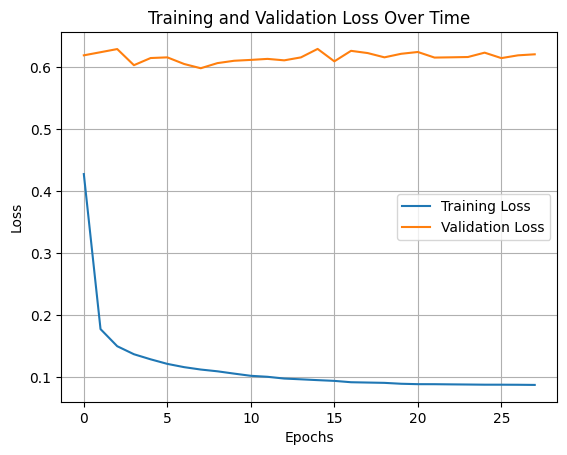

Model saved to /kaggle/working/improved_dehazenet.pth


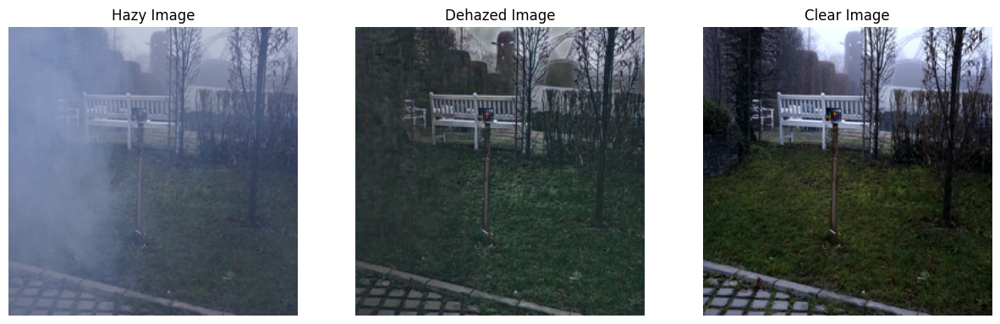

In [24]:
model = ImprovedDehazeNet(num_residual_blocks=6).to(device)
model.apply(initialize_weights)  # Apply weight initialization
train_model(model, train_loader,val_loader)

# Save the model
model_save_path = '/kaggle/working/improved_dehazenet.pth'
torch.save(model.state_dict(), model_save_path)
print(f"Model saved to {model_save_path}")

# Example of visualizing outputs for the first image in the dataset
example_hazy_image = hazy_images[0:1]
example_clear_image = clear_images[0:1]
example_dcp_image = dcp_images[0:1]
dehazed_image = model(example_hazy_image.to(device), example_dcp_image.to(device))

visualize_outputs(example_hazy_image[0], example_clear_image[0], dehazed_image[0])

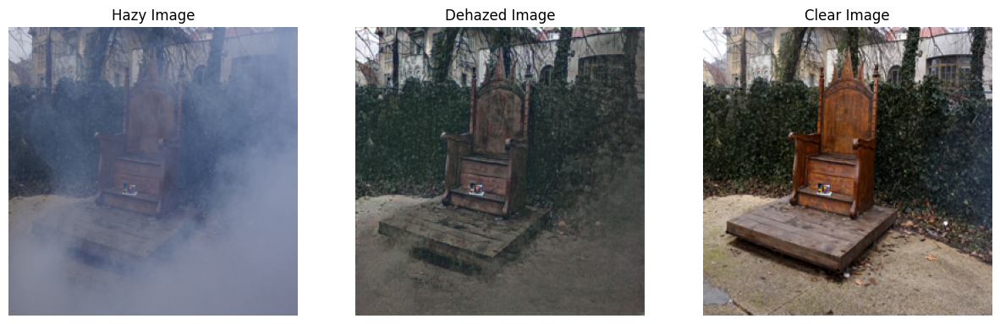

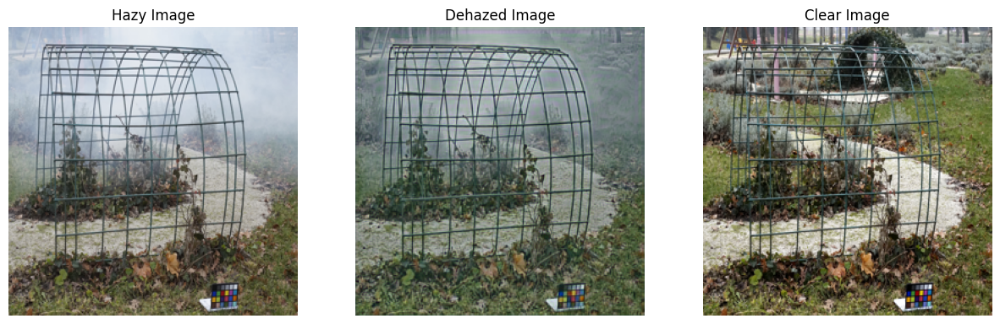

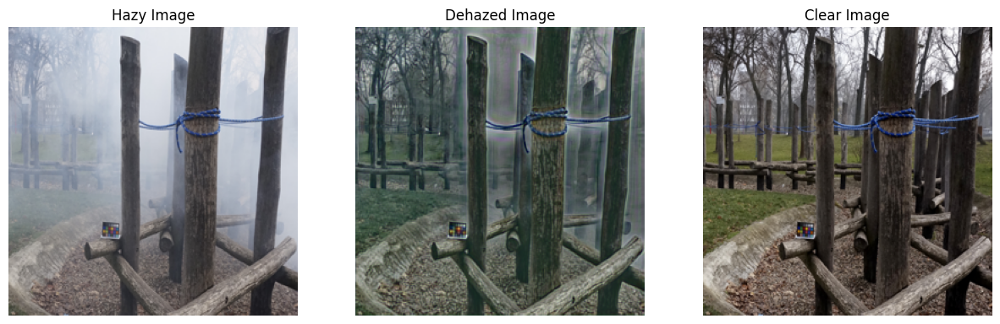

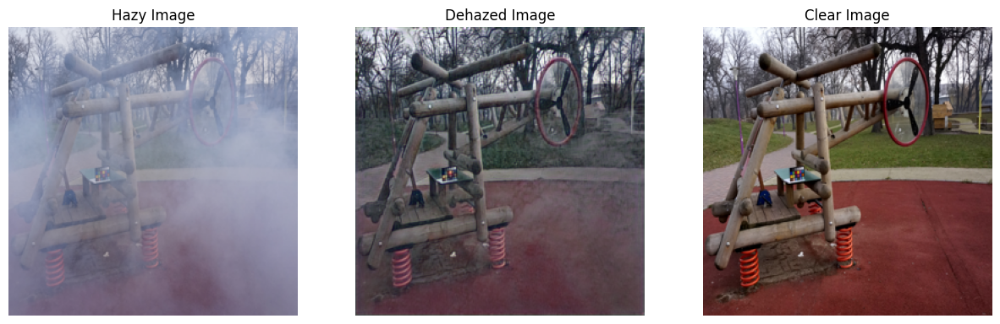

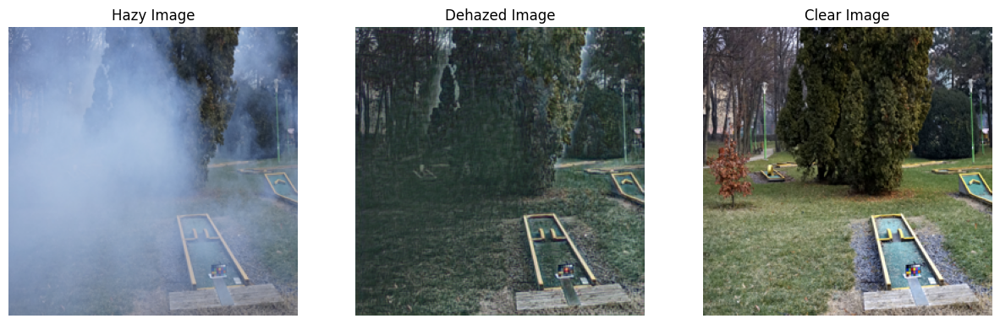

...

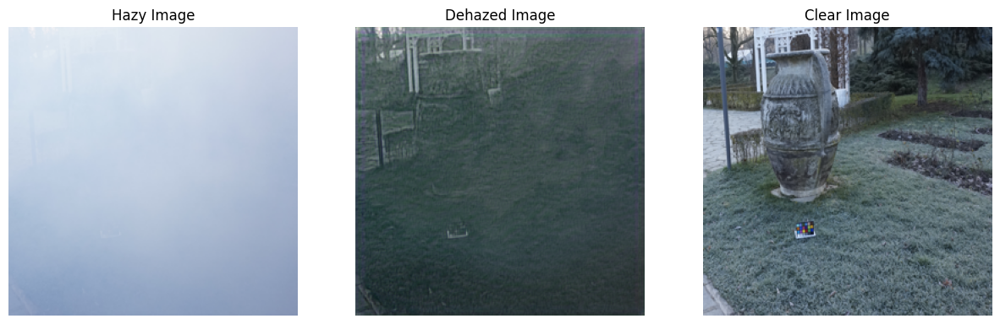

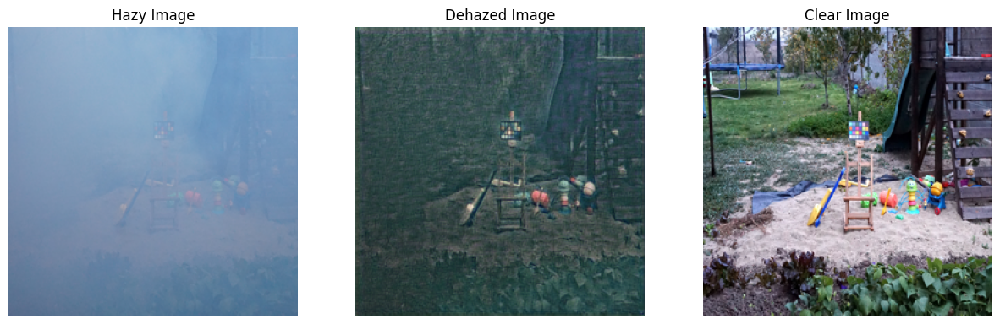

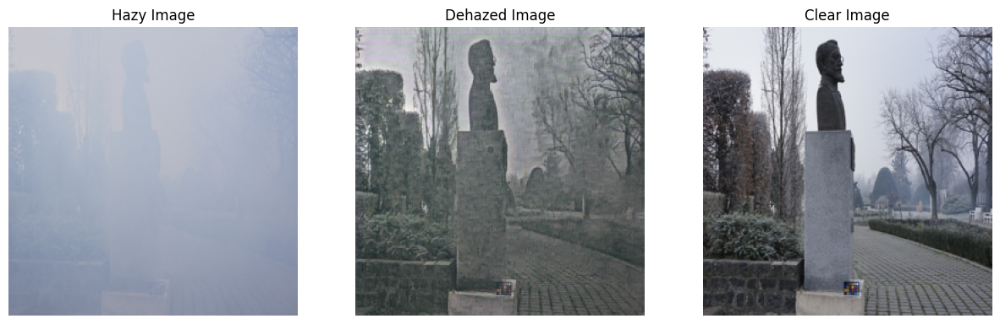

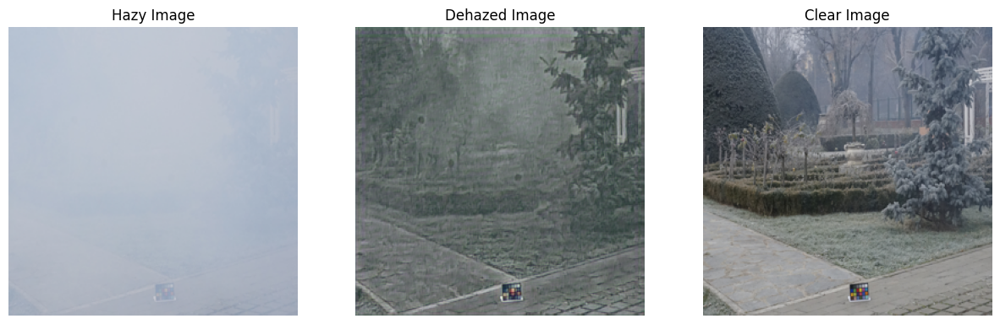

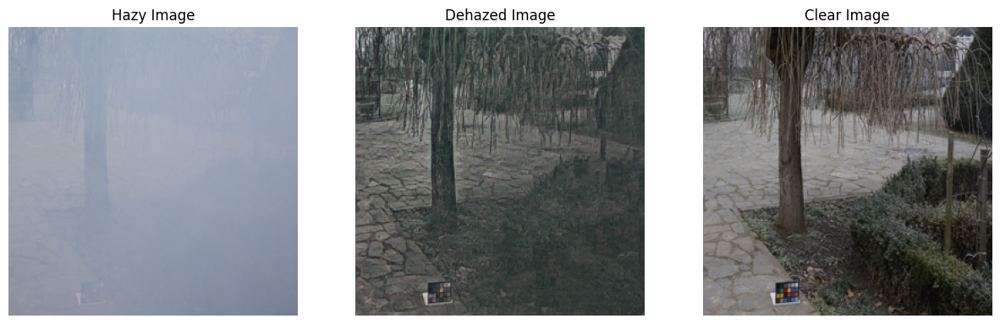

In [25]:
for i in range(21,75):
    example_hazy_image = hazy_images[i:i+1]
    example_clear_image = clear_images[i:i+1]
    example_dcp_image = dcp_images[i:i+1]
    dehazed_image = model(example_hazy_image.to(device), example_dcp_image.to(device))

    visualize_outputs(example_hazy_image[0], example_clear_image[0], dehazed_image[0])